# Part II: Testing Models for Clustering and Cell Type Annotation

## Introduction

In this section, we focus on testing various models for clustering and performing a first attempt at cell type annotation. We build upon our initial data preprocessing and now incorporate treatment information, as well as references from both **CZI** ([Guimarães et al. (2024) Nat Commun](https://cellxgene.cziscience.com/collections/3f7c572c-cd73-4b51-a313-207c7f20f188)) and the **Tabula Muris** skin dataset ([Tabula Muris Tutorial](https://docs.scvi-tools.org/en/stable/tutorials/notebooks/scrna/tabula_muris.html)). Our dataset comprises 60 samples, grouped by two time points (8 days and 4 days), and each time point is further organized into 10 subgroups of 3 samples each, resulting in a structured experimental design.

The overall goal here is to integrate treatment, batch, and time point information into a comprehensive analytical framework. This involves dimensionality reduction (PCA), normalization checks, deconvolution strategies, and cell type annotation. By doing so, we aim to better understand the underlying biology and the interplay between technical and biological variation.

## Overview of Analysis Steps

1. **Box Plots of Library Size Before and After Normalization**:  
   We will generate box plots of library sizes, color-coded by treatment and time, both before and after normalization. This will help us assess how normalization affects data distribution across different experimental conditions.

2. **Strategies to Determine Similarity and Clustering**:  
   We will apply three distinct strategies to deconvolve gene expression features, aiming to improve our ability to cluster cells and identify cell populations:
   - **Harmony**: A method for batch correction and integration.
   - **Variational Autoencoder (VAE)**: A deep learning–based approach to model the underlying gene expression distributions.
   - **Probability Modeling**: Statistical methods that model the data distribution to infer underlying cell-type structures.

3. **Automated Cell Type Transfer Using Logistic Regression**:  
   We will employ a logistic regression–based cell typing package to automatically transfer annotations from reference datasets (CZI and Tabula Muris) to our own data. This approach leverages known cell-type profiles to classify cells in our samples.

4. **UMAP Visualization of Clusters by Batch and Treatment**:  
   We will generate UMAP embeddings to visualize clusters resulting from each deconvolution method. By coloring cells by batch and treatment groups, we can visually inspect batch effects and treatment-related changes within the low-dimensional space.

5. **Comparing Batch and Biological Effects**:  
   Finally, we will compare the magnitude of batch effects to the biological effects (e.g., treatment and time points) to understand how effectively our methods separate technical variability from true biological signal.

Overall, this analysis aims to refine our understanding of data structure, improve clustering strategies, and ensure robust and meaningful annotation of cell populations.


```
source myconda  
mamba activate scvi_env
```

In [9]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)


In [10]:
import scanpy as sc
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns

In [11]:
pathout = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/out_1'
adata_concat = sc.read_h5ad(os.path.join(pathout, "andata_filter_logNorm_hvg.h5ad"))
df = adata_concat.obs[['log1p_total_counts','cell_area','nucleus_area','nucleus_count','batch']]
sorted_categories = sorted(df['batch'].cat.categories, key=lambda x: int(x))
df.loc[:, 'batch'] = df['batch'].cat.reorder_categories(sorted_categories, ordered=True)
sorted_df = df.sort_values(by='batch')
unique_batches_numpy = sorted_df['batch'].cat.categories.to_numpy()

# Overlapping Densities Plot - Library Depth, log-normalized reads count

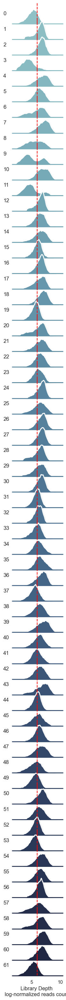

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the theme
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Define palette
pal = sns.cubehelix_palette(len(unique_batches_numpy), rot=-.25, light=.7)

# Initialize FacetGrid
g = sns.FacetGrid(sorted_df, row="batch", hue="batch", aspect=5, height=.5, palette=pal)

# Draw the densities
g.map(sns.kdeplot, "log1p_total_counts", bw_adjust=.5, clip_on=False, fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "log1p_total_counts", clip_on=False, color="w", lw=2, bw_adjust=.5)


def add_mean_line(**kwargs):
    mean_value = np.round(np.mean(sorted_df['log1p_total_counts'].values),0)
    plt.axvline(mean_value, color='red', linestyle='--', linewidth=1.5)

g.map(add_mean_line)
# Add a reference line
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-0.25)

# Limit the x-axis
#g.set(xlim=(0, 2000))

g.set_titles("")

# Change x-axis label
g.set_axis_labels("Library Depth \n log-normalized reads counts", None)

# Properly align batch labels on the y-axis
for ax, label in zip(g.axes.flat, unique_batches_numpy):
    ax.set_ylabel(f"{label}", rotation=0, ha='left', va='center', labelpad=20)

# Remove unnecessary plot details
g.set(yticks=[])
g.despine(bottom=True, left=True)

# Show plot
plt.show()


In [12]:
def andataADDcovarite_origstring(andtata_in):
    from tqdm import tqdm
    Experimental_design_file = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/Experimental_design/Experimental_Design.csv'
    ed = pd.read_csv(Experimental_design_file)
    column_sel = ed.columns[2:4].tolist()+ed.columns[5:11].tolist()
    # adding covrites per batch to andata
    for column in column_sel:
        andtata_in.obs[column] = None
        for batch in ed['Polygon']:
            covraite_temp = ed.loc[ed["Polygon"]==batch,column].values.tolist()*len(andtata_in.obs.loc[andtata_in.obs["batch"]==str(batch),column])
            andtata_in.obs.loc[andtata_in.obs["batch"]==str(batch),column] = covraite_temp

In [13]:
andataADDcovarite_origstring(adata_concat)

In [14]:
df = adata_concat.obs[['total_counts','log1p_total_counts','cell_area','nucleus_area','nucleus_count','batch','Condition ','Technical_repeat','Harvest_Day']]
sorted_categories = sorted(df['batch'].cat.categories, key=lambda x: int(x))
df.loc[:, 'batch'] = df['batch'].cat.reorder_categories(sorted_categories, ordered=True)

In [24]:
def run_box(df,condition,ax,ylab = "Library Depth \n (log-normalized)",column_count = "log1p_total_counts",yaxsis_info = True, y_lim = (0,10),yticks = [2,8],yticks_lab = ['2', '8'], **kwargs):
    if yaxsis_info:
        ax.set_ylim(y_lim[0],y_lim[1])
        ax.set_yticks(yticks)
        ax.set_yticklabels(yticks_lab)  # Set y-axis tick labels explicitly
        # Adjust y-axis tick appearance
        ax.tick_params(axis='y', direction='out', length=5, color='black', width=1)
    df_temp = df.loc[df['Condition ']==condition,:]
    count = 0
    for day in [4, 8]:
        df_temp_con = df_temp.loc[df_temp['Harvest_Day']==day,:]
        unique_cond = pd.unique(df_temp_con['Technical_repeat'])
        for i,un in enumerate(unique_cond):
            cur = df_temp_con.loc[df_temp_con['Technical_repeat']==un,column_count].values
            positions = count
            count +=1
            g = ax.boxplot(x = [cur],
                        positions=[positions],
                        widths=0.5,
                        patch_artist=True,  # Allow color filling
                        boxprops=dict(facecolor="grey" if day==4 else "red", edgecolor="black", linewidth=1.5),  # Customize box style
                        **kwargs
                          )
    ax.set_title(condition)
    ax.set_xticks([])
    ax.set_xticklabels([])
    ax.tick_params(axis='x', direction='out', length=5, color='black')
    ax.set_ylabel(ylab)

In [1]:
# sns.set_theme(style="white", palette=None)
# plt.rcParams['figure.dpi'] = 100
# plt.rcParams['font.family'] = ['serif']
# plt.rcParams['font.size'] = 12
# plt.rcParams['axes.labelsize'] = 12
# plt.rcParams['axes.titlesize'] = 12
# plt.rcParams['xtick.labelsize'] = 12
# plt.rcParams['ytick.labelsize'] = 12

# con_list = ['Mock ', 'TCR', 'IL-21', 'IL-15', 'Both']

# fig, ax = plt.subplots(2, 3, figsize=(10,7),sharey=all)
# ax = ax.ravel()
# for i,con in enumerate(con_list):
#     run_box(df,ylab = "Library Depth",condition=con,ax = ax[i],column_count = 'total_counts',yaxsis_info = True,y_lim = (0,4000),yticks = [],yticks_lab = [],showfliers= False)
# fig.delaxes(ax[-1])
# plt.subplots_adjust(wspace = 0.3, hspace=0.2)


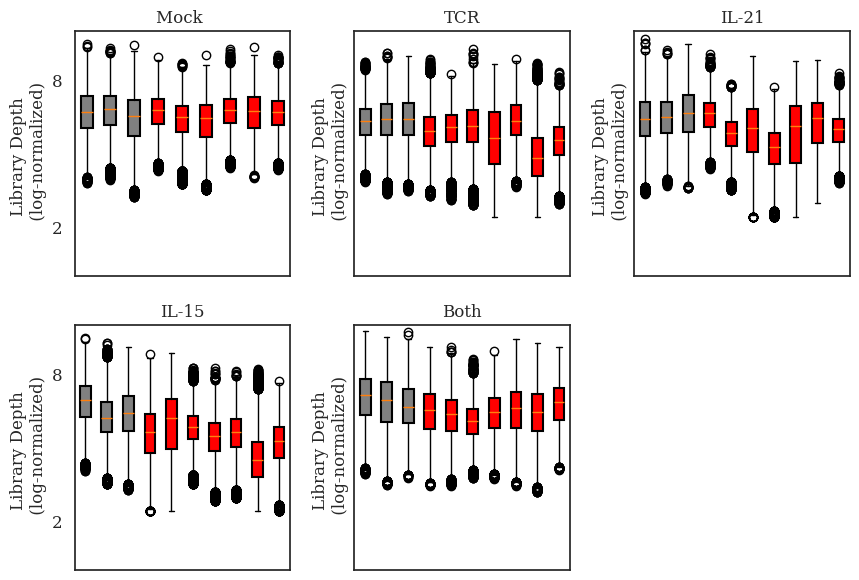

In [30]:
sns.set_theme(style="white", palette=None)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

con_list = ['Mock ', 'TCR', 'IL-21', 'IL-15', 'Both']

fig, ax = plt.subplots(2, 3, figsize=(10,7),sharey=all)
ax = ax.ravel()
for i,con in enumerate(con_list):
    run_box(df,condition=con,ax = ax[i])
fig.delaxes(ax[-1])
plt.subplots_adjust(wspace = 0.3, hspace=0.2)

# Strategies to Determine Similarity and Clustering


Given the nature of this data, there may be technical and biological effects that could obscure the relevant biological signals we aim to study. As an initial test, we will evaluate the biological and technical differences in the dataset. A well-balanced dataset should exhibit well-clustered integration across samples.

In [1]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.colors import ListedColormap
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import os
import gzip
import numpy as np
import scanpy as sc
import squidpy as sq
import cupy as cp
import cupyx
from cupyx.scipy.sparse import csr_matrix 
import os
import time
import rapids_singlecell as rsc
import numpy as np
import rmm
from rmm.allocators.cupy import rmm_cupy_allocator
import cupy

rmm.reinitialize(
    managed_memory=False,  # Allows oversubscription
    pool_allocator=False,  # default is False
    devices=0,  # GPU device IDs to register. By default registers only GPU 0.
)
cp.cuda.set_allocator(rmm_cupy_allocator)
import zarr
import pickle
from collections import OrderedDict
from scipy.sparse import csr_matrix
import pandas as pd
import scipy.stats as stats
from statsmodels.stats.multitest import multipletests
from scipy.sparse import csr_matrix
import scipy
import anndata
from collections import OrderedDict
import anndata as ad
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

In [3]:
pathout = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/out_1'
adata_concat = sc.read_h5ad(os.path.join(pathout, "andata_filter_logNorm_hvg_leiden_harmony_scvi_con_mouse_cov_umap.h5ad"))
Experimental_design_file = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/Experimental_design/Experimental_Design.csv'
ed = pd.read_csv(Experimental_design_file)
column_sel = ed.columns[2:4].tolist()+ed.columns[5:8].tolist()

from tqdm import tqdm
# adding covrites per batch to andata
for column in column_sel:
    adata_concat.obs[column] = None
    for batch in tqdm(ed['Polygon']):
        covraite_temp = ed.loc[ed["Polygon"]==batch,column].values.tolist()*len(adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column])
        adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column] = covraite_temp
        # if isinstance(adata_concat.obs[column].dtype, pd.CategoricalDtype):
        #     print('not') 
        # else:
        #     adata_concat.obs[column] = adata_concat.obs[column].astype("category")

100%|█████████████████████████████████████████████████████████████████████████████████████| 62/62 [00:00<00:00, 190.44it/s]


In [4]:
adata_concat.obs['Condition '] = adata_concat.obs['Condition '].astype("category")
adata_concat.obs['Technical_repeat'] = adata_concat.obs['Technical_repeat'].astype("category")
adata_concat.obs['Mouse_ID'] = adata_concat.obs['Mouse_ID'].astype("category")
adata_concat.obs['Harvest_Day'] = adata_concat.obs['Harvest_Day'].astype("category")

In [5]:
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """
    slide = adata[adata.obs[s_col]==s,:].copy()
    return slide

In [6]:
sample_sel = [58,54,50,26,1,56,27,30]
sample_sel = [str(i) for i in sample_sel]
mock_andata = ad.concat([select_slide(adata_concat,s = b, s_col = "batch") for b in sample_sel])

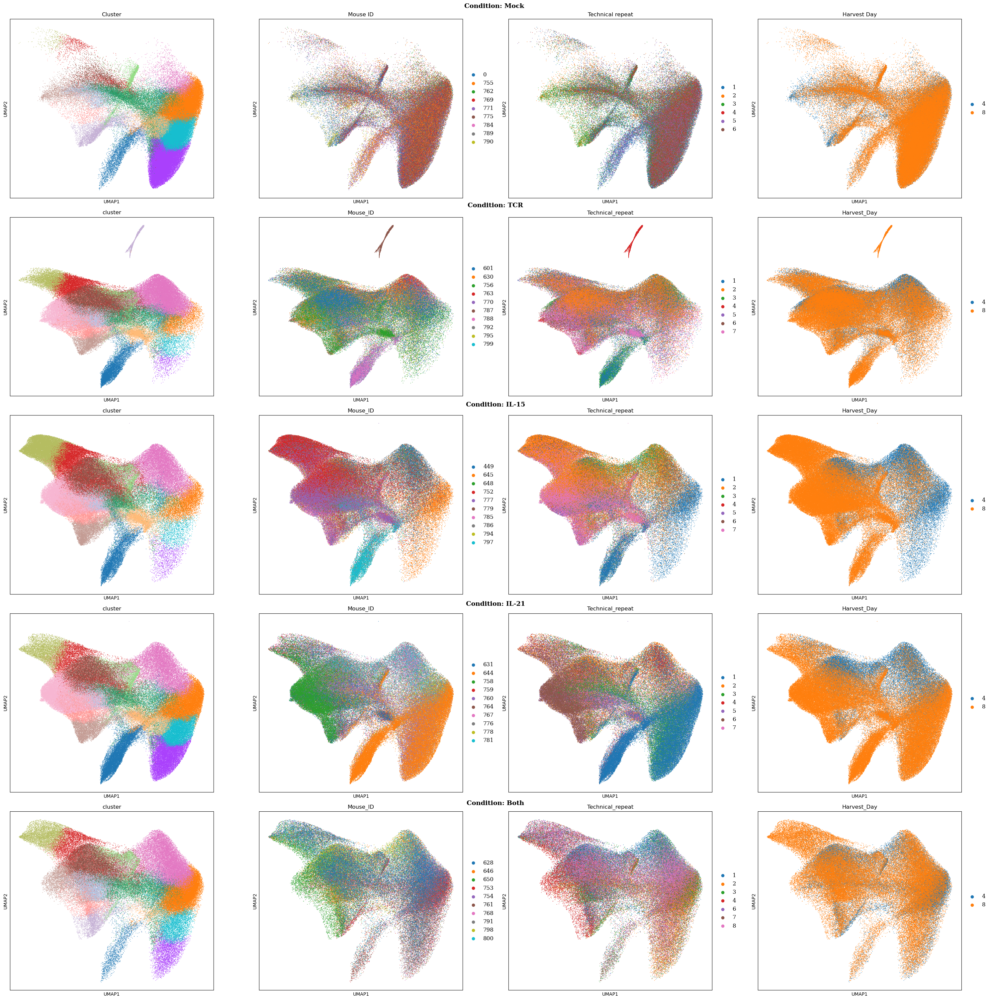

In [7]:
fig, ax = plt.subplots(5, 4, figsize=(30,30))
ax = ax.ravel()

# Adjust matplotlib settings
plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

count = 0 
postion_title = [1,0.8,0.6,0.4,0.2]
for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    tempdf = ed.loc[ed['Condition '] == str(con)]
    samples = [str(i) for i in pd.unique(tempdf['Polygon']).tolist()]
    sel_andata = ad.concat([select_slide(adata_concat,s = b, s_col = "batch") for b in samples])
    # Directly use the UMAP data from 'harmony_umap'
    sel_andata.obsm['X_umap'] = sel_andata.obsm['Unintegrated_umap']
    sc.pl.umap(sel_andata, color="cluster", ax=ax[count], show=False,size = 5,legend_loc = None)
    count += 1
    sc.pl.umap(sel_andata, color="Mouse_ID", ax=ax[count], show=False,size =5)
    count += 1
    sc.pl.umap(sel_andata, color="Technical_repeat", ax=ax[count], show=False,size = 5)
    count += 1
    sc.pl.umap(sel_andata, color="Harvest_Day", ax=ax[count], show=False,size =5)
    count += 1

    fig.text(
        0.5,                           # X-coordinate (center of the figure)
        row_idx,     # Y-coordinate (adjusted by row index)
        f"Condition: {con}",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=14, fontweight='bold'
    )
    
    # Add titles to individual plots
    ax[0].set_title("Cluster")
    ax[1].set_title("Mouse ID")
    ax[2].set_title("Technical repeat")
    ax[3].set_title("Harvest Day")

#plt.suptitle("Unintegrated", fontsize=16, fontweight='bold')
# Adjust layout to avoid overlaps
plt.tight_layout()

# Show the plot
plt.show()

Visually examining the embedding space, cell types separate without integration, yet clusters mix across covariate groups. However, one cluster seems biologically influenced, being enriched in a specific mouse type and condition (TCR) at 8 days.

# Comparing Batch and Biological Effects

To see if improvements are possible, we decided to test three integration methods: Harmony, scVI, and cell2location. These results will be compared using several evaluation metrics to assess batch correction and biological conservation. The goal is to correct batch effects while minimally impacting biological traits.

In [1]:
import os
import tempfile

from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.backends.backend_pdf import PdfPages
import random
import pandas as pd


import numpy as np
import scanpy as sc
import seaborn as sns
#import torch
from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection

import faiss

from scib_metrics.nearest_neighbors import NeighborsResults
import anndata as ad

In [2]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="scib_metrics.benchmark")

In [3]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

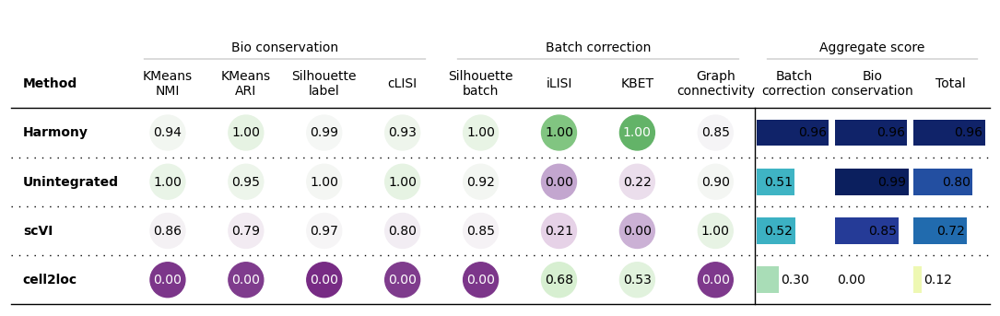

In [6]:
result_dir ='/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/results_spec/scbi'
import pickle
with open(os.path.join(result_dir,"benchmarker.pkl"), "rb") as file:
    bm = pickle.load(file)
_ = bm.plot_results_table()

While bio-conservation performance is similar between Harmony and unintegration, Harmony significantly outperforms in correcting batch effects.

In [2]:
pathout = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/out_1'
adata_concat = sc.read_h5ad(os.path.join(pathout, "andata_filter_logNorm_hvg_leiden_harmony_scvi_con_mouse_cov_umap.h5ad"))
Experimental_design_file = '/data/kanferg/Sptial_Omics/projects/NguyenLab/spatialomicstoolkit/Experimental_design/Experimental_Design.csv'
ed = pd.read_csv(Experimental_design_file)
column_sel = ed.columns[2:4].tolist()+ed.columns[5:8].tolist()

from tqdm import tqdm
# adding covrites per batch to andata
for column in column_sel:
    adata_concat.obs[column] = None
    for batch in tqdm(ed['Polygon']):
        covraite_temp = ed.loc[ed["Polygon"]==batch,column].values.tolist()*len(adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column])
        adata_concat.obs.loc[adata_concat.obs["batch"]==str(batch),column] = covraite_temp
adata_concat.obs['Condition '] = adata_concat.obs['Condition '].astype("category")
adata_concat.obs['Technical_repeat'] = adata_concat.obs['Technical_repeat'].astype("category")
adata_concat.obs['Mouse_ID'] = adata_concat.obs['Mouse_ID'].astype("category")
adata_concat.obs['Harvest_Day'] = adata_concat.obs['Harvest_Day'].astype("category")
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """
    slide = adata[adata.obs[s_col]==s,:].copy()
    return slide

100%|█████████████████████████████████████████████████████████████████████████████████████| 62/62 [00:00<00:00, 190.98it/s]


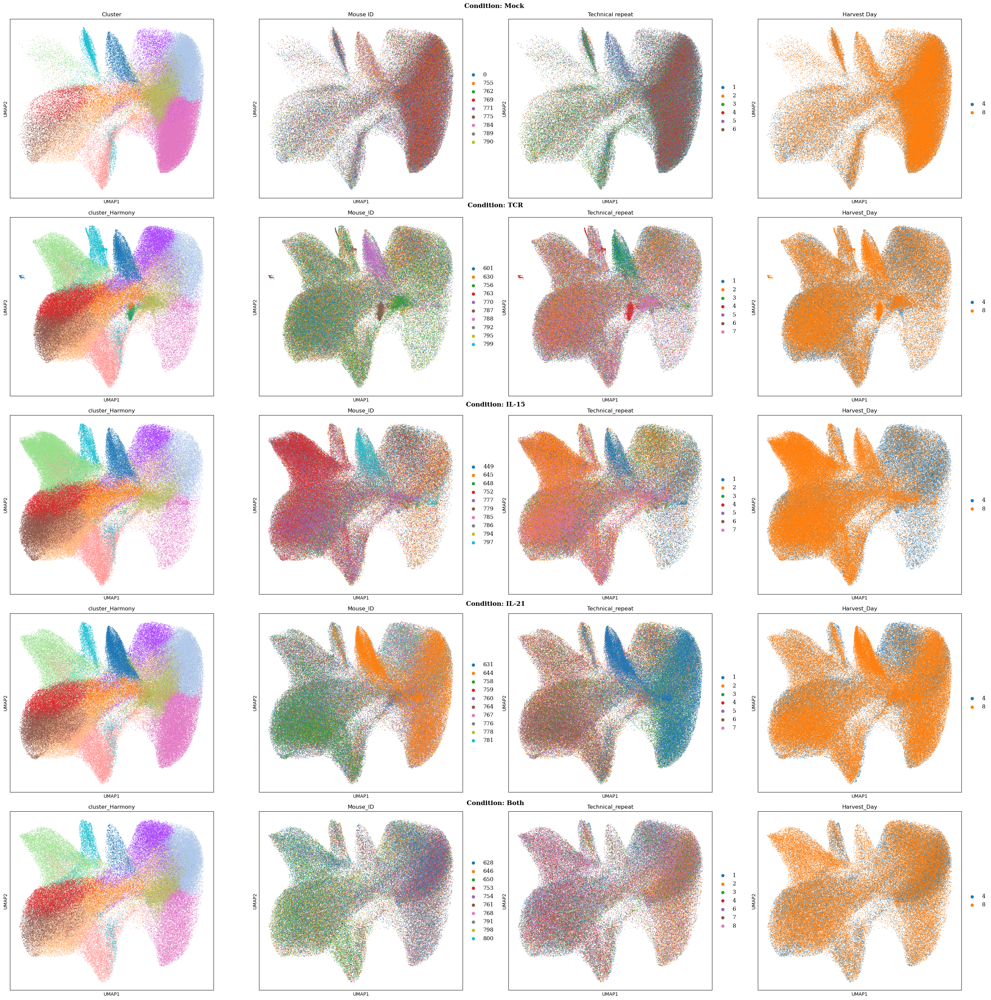

In [4]:
fig, ax = plt.subplots(5, 4, figsize=(30,30))
ax = ax.ravel()

# Adjust matplotlib settings
plt.rcParams['figure.dpi'] = 92
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

count = 0 
postion_title = [1,0.8,0.6,0.4,0.2]
for row_idx,con in zip(postion_title,pd.unique(ed['Condition '])):
    tempdf = ed.loc[ed['Condition '] == str(con)]
    samples = [str(i) for i in pd.unique(tempdf['Polygon']).tolist()]
    sel_andata = ad.concat([select_slide(adata_concat,s = b, s_col = "batch") for b in samples])
    # Directly use the UMAP data from 'harmony_umap'
    sel_andata.obsm['X_umap'] = sel_andata.obsm['harmony_umap']
    sc.pl.umap(sel_andata, color="cluster_Harmony", ax=ax[count], show=False,size = 5,legend_loc = None)
    count += 1
    sc.pl.umap(sel_andata, color="Mouse_ID", ax=ax[count], show=False,size =5)
    count += 1
    sc.pl.umap(sel_andata, color="Technical_repeat", ax=ax[count], show=False,size = 5)
    count += 1
    sc.pl.umap(sel_andata, color="Harvest_Day", ax=ax[count], show=False,size =5)
    count += 1

    fig.text(
        0.5,                           # X-coordinate (center of the figure)
        row_idx,     # Y-coordinate (adjusted by row index)
        f"Condition: {con}",           # Text for the row title
        ha='center',                   # Horizontal alignment
        va='center',                   # Vertical alignment
        fontsize=14, fontweight='bold'
    )
    
    # Add titles to individual plots
    ax[0].set_title("Cluster")
    ax[1].set_title("Mouse ID")
    ax[2].set_title("Technical repeat")
    ax[3].set_title("Harvest Day")

#plt.suptitle("Unintegrated", fontsize=16, fontweight='bold')
# Adjust layout to avoid overlaps
plt.tight_layout()

# Show the plot
plt.show()

Validating the model evaluation step confirms that Harmony correction effectively addresses the mouse condition and time effects. 